<a href="https://colab.research.google.com/github/SERVIR/RX_fires/blob/main/TNC_Burn_Severity_Training_data_generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Testign with Flame dataset: https://ieee-dataport.org/open-access/flame-dataset-aerial-imagery-pile-burn-detection-using-drones-uavs

Alireza Shamsoshoara, Fatemeh Afghah, Abolfazl Razi, Liming Zheng, Peter Fulé, Erik Blasch, "The FLAME dataset: Aerial Imagery Pile burn detection using drones (UAVs)", IEEE Dataport, November 19, 2020, doi:10.21227/qad6-r683

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pwd

/content


In [6]:
!pip install pymupdf

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.1/24.1 MB 37.0 MB/s eta 0:00:00


In [18]:
import fitz  # PyMuPDF
import os

pdf_path = '/content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/Monitoring_Pics_2025.pdf'
output_dir = '/content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images'
os.makedirs(output_dir, exist_ok=True)

doc = fitz.open(pdf_path)

img_count = 0
for page_num in range(len(doc)):
    page = doc[page_num]
    image_list = page.get_images(full=True)
    print(f"Found {len(image_list)} images on page {page_num}")

    for img_index, img in enumerate(image_list):
        xref = img[0]
        base_image = doc.extract_image(xref)
        image_bytes = base_image["image"]
        image_ext = base_image["ext"]
        img_filename = f"page{page_num}_img{img_index}.{image_ext}"
        img_filepath = os.path.join(output_dir, img_filename)

        with open(img_filepath, "wb") as f:
            f.write(image_bytes)

        img_count += 1

print(f"Extracted {img_count} images to {output_dir}")


Found 1 images on page 0
Found 1 images on page 1
Found 1 images on page 2
Found 1 images on page 3
Found 1 images on page 4
Found 1 images on page 5
Found 0 images on page 6
Extracted 6 images to /content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images


In [30]:
from PIL import Image
import os

input_dir = '/content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images'
output_dir = os.path.join(input_dir, 'split_images')
os.makedirs(output_dir, exist_ok=True)
print(f"Output directory: {output_dir}")

num_splits = 2  # Number of stacked images (e.g. pre and post)
edge_crop = 10  # Pixels to crop from edges to remove poor parts

for filename in os.listdir(input_dir):
    if not filename.lower().endswith(('.jpg', '.jpeg', '.png')):
        continue

    img_path = os.path.join(input_dir, filename)
    print(f"Processing image: {img_path}")
    img = Image.open(img_path)
    width, height = img.size
    single_height = height // num_splits

    for i in range(num_splits):
        top = i * single_height + edge_crop
        bottom = (i + 1) * single_height - edge_crop
        if bottom <= top:
            top = i * single_height
            bottom = (i + 1) * single_height

        box = (0, top, width, bottom)
        split_img = img.crop(box)

        split_img_path = os.path.join(output_dir, f"{os.path.splitext(filename)[0]}_part{i+1}.jpeg")
        split_img.save(split_img_path)
        print(f"Saved split image: {split_img_path}")


Output directory: /content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images
Processing image: /content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/page0_img0.jpeg
Saved split image: /content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images/page0_img0_part1.jpeg
Saved split image: /content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images/page0_img0_part2.jpeg
Processing image: /content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/page1_img0.jpeg
Saved split image: /content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire

Found 12 images in /content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images
Displaying: page0_img0_part1.jpeg


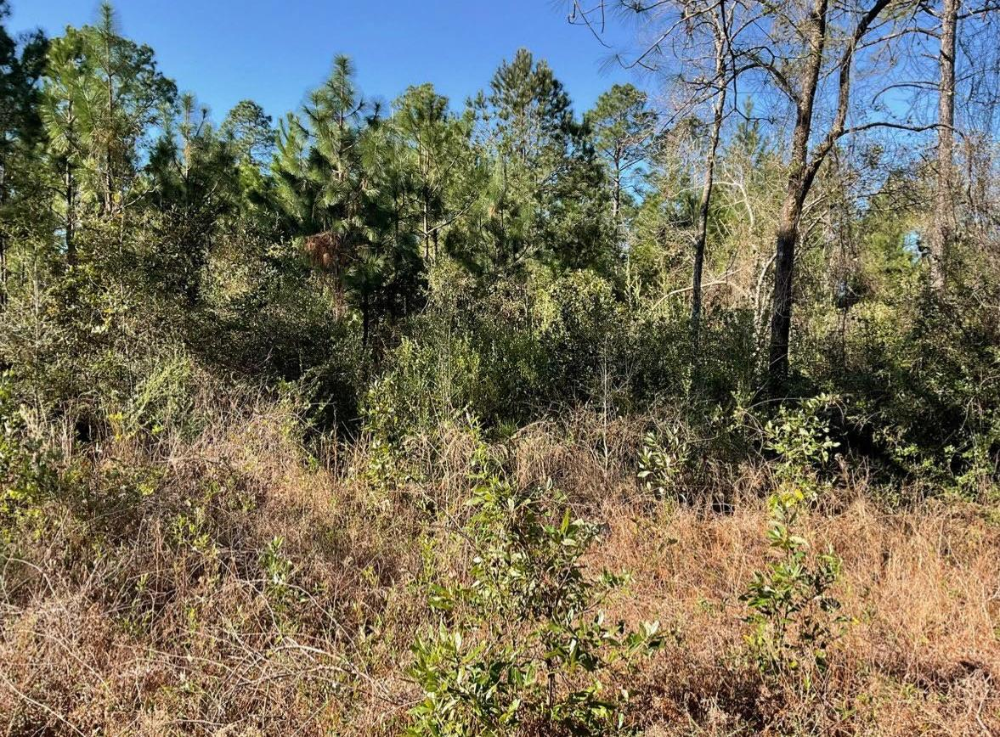

Displaying: page0_img0_part2.jpeg


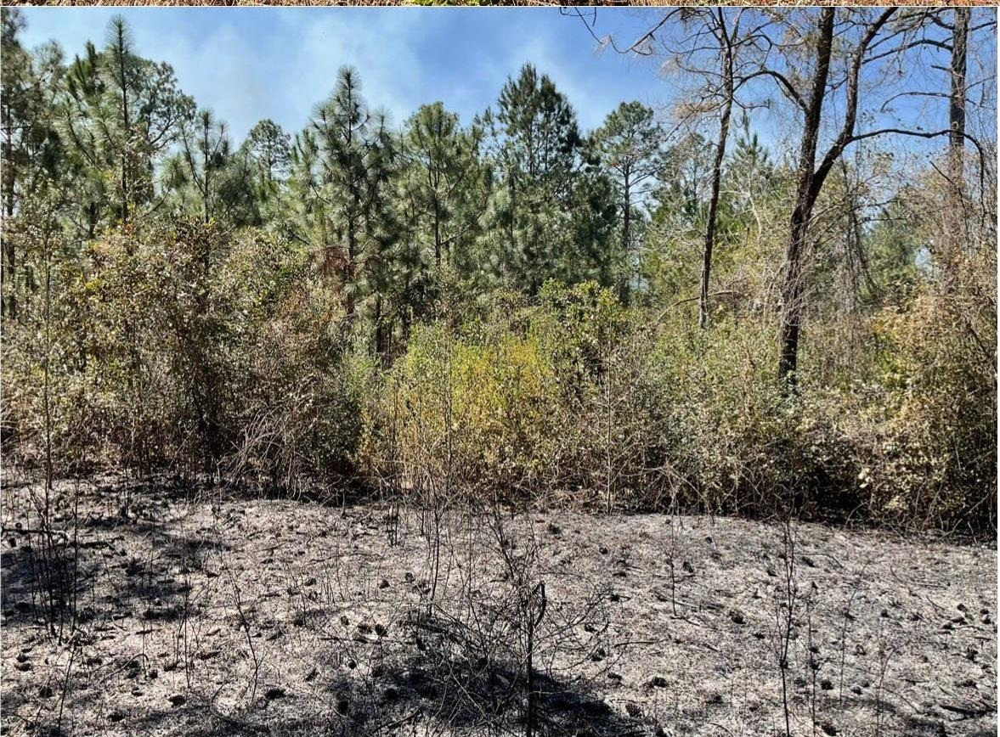

Displaying: page1_img0_part1.jpeg


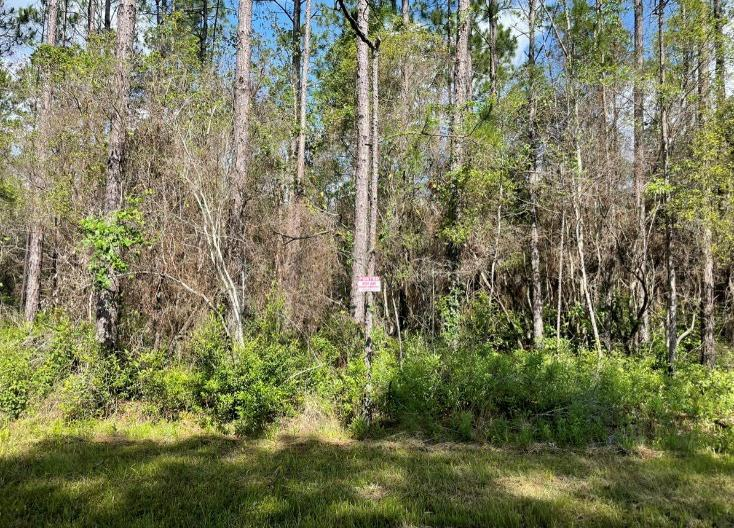

Displaying: page1_img0_part2.jpeg


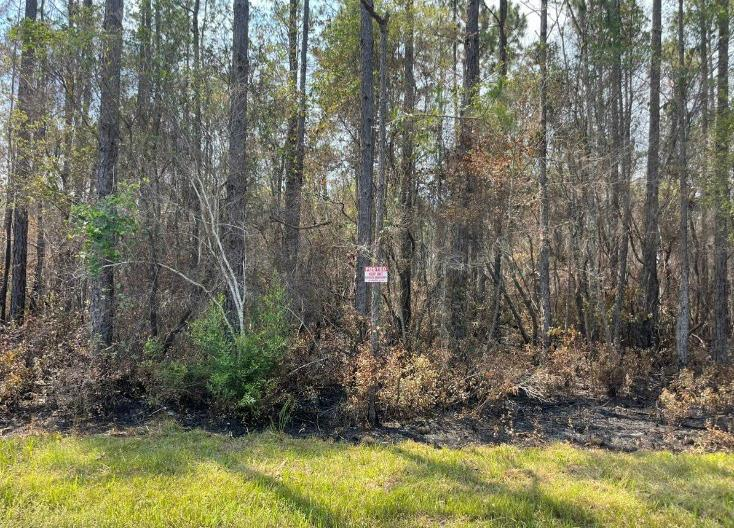

Displaying: page2_img0_part1.jpeg


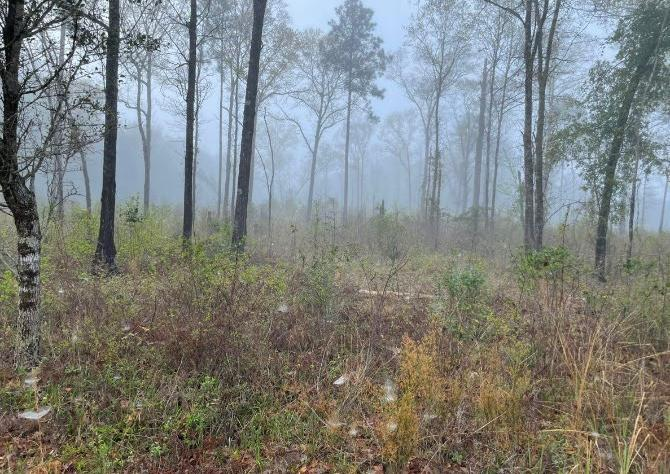

Displaying: page2_img0_part2.jpeg


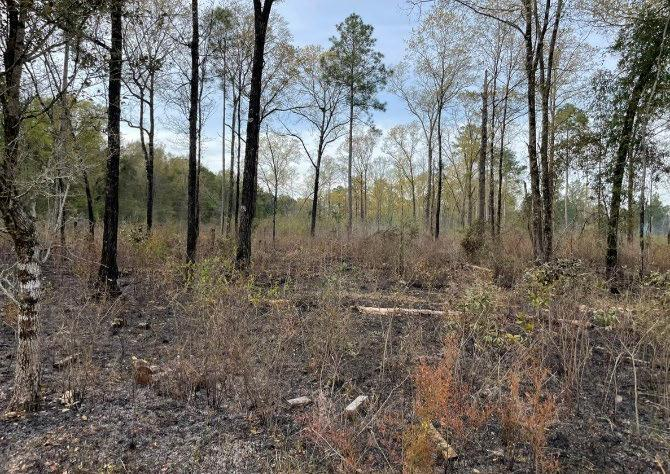

Displaying: page3_img0_part1.jpeg


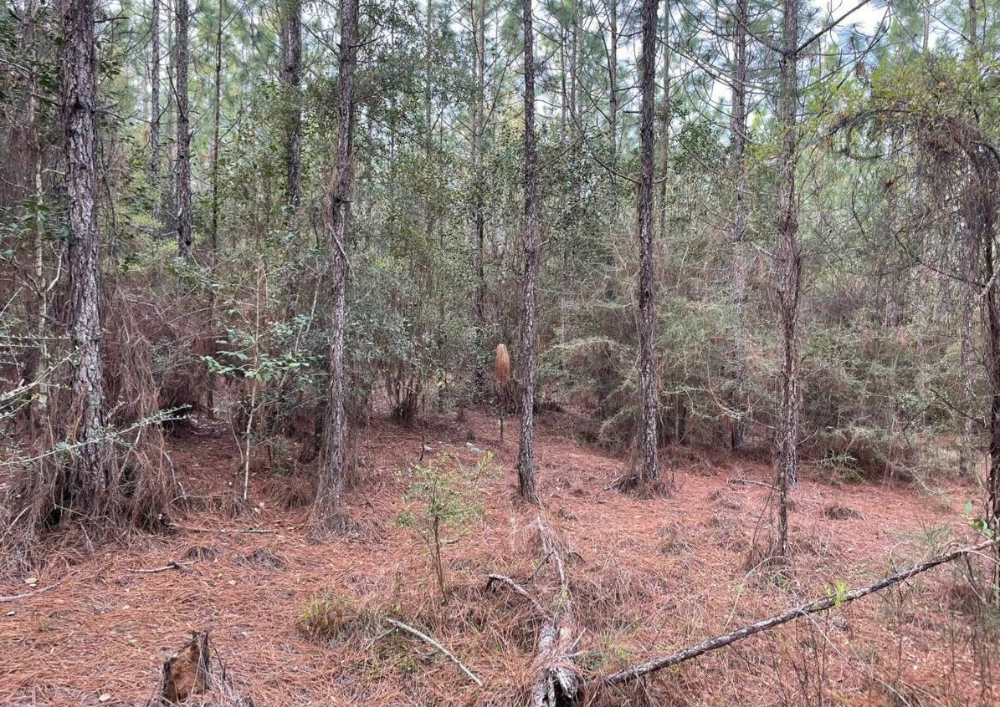

Displaying: page3_img0_part2.jpeg


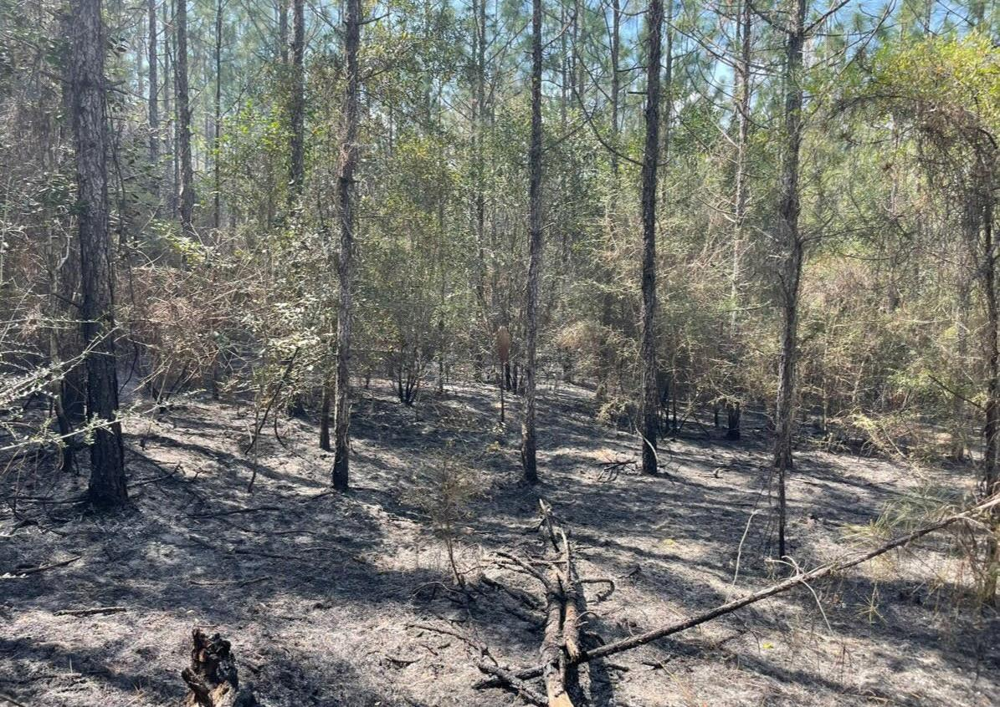

Displaying: page4_img0_part1.jpeg


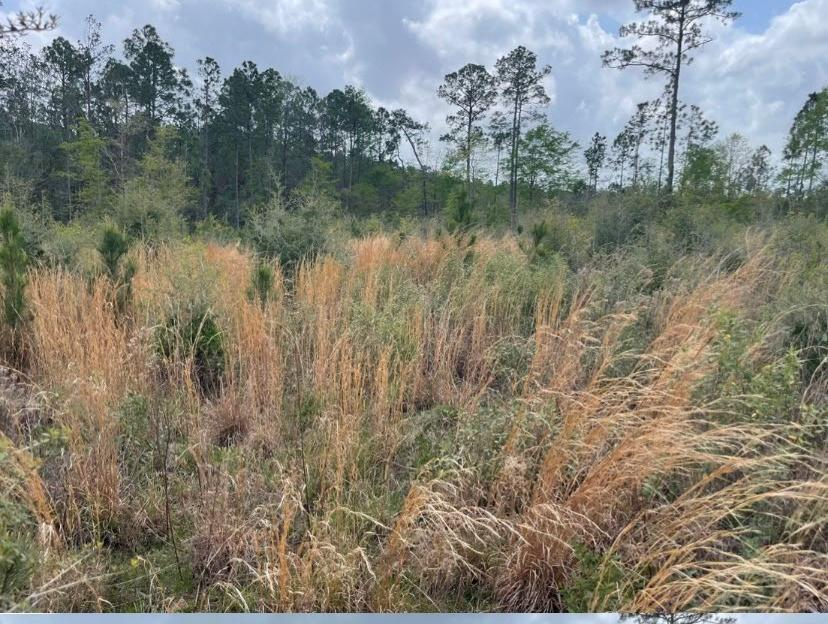

Displaying: page4_img0_part2.jpeg


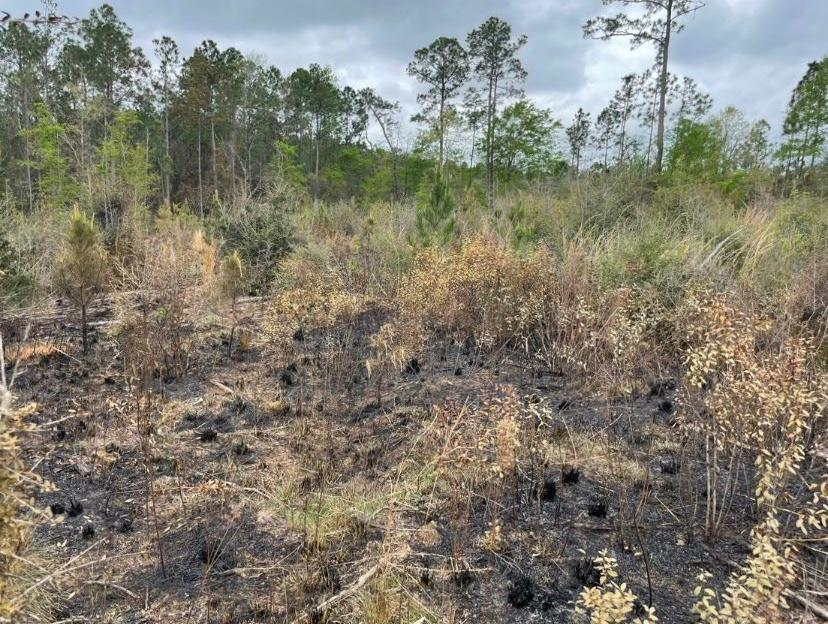

Displaying: page5_img0_part1.jpeg


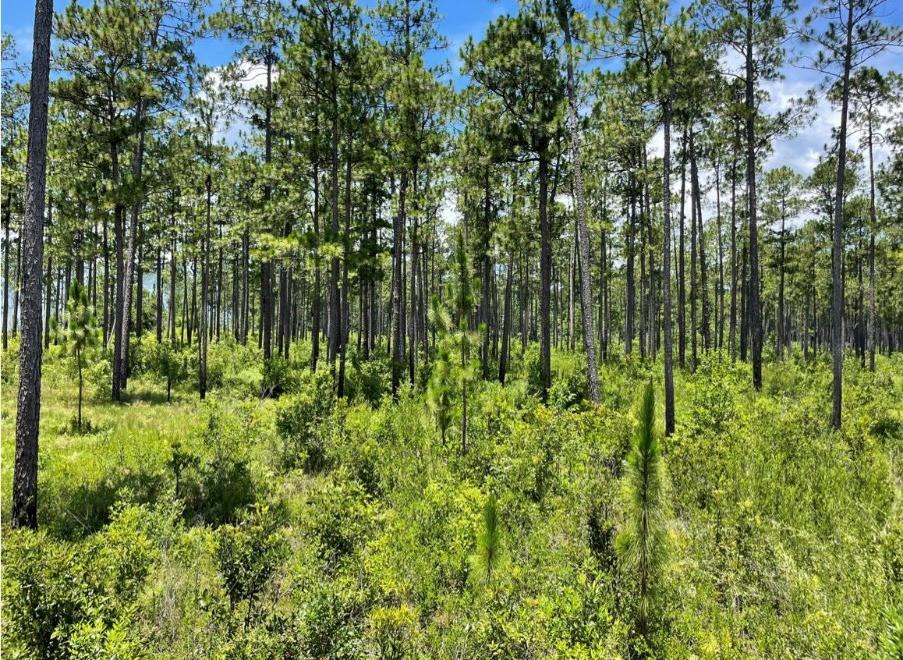

Displaying: page5_img0_part2.jpeg


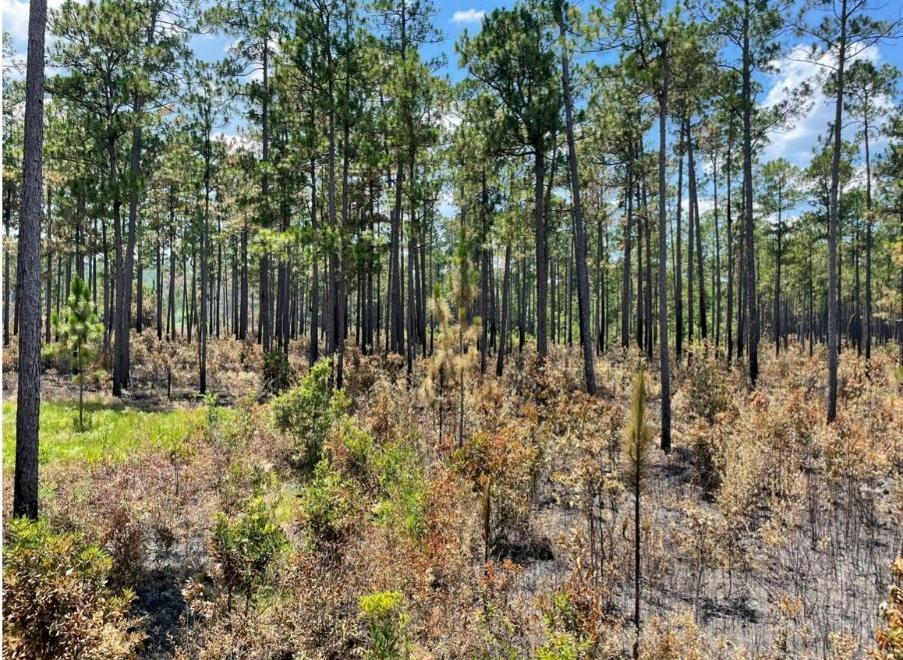

In [31]:
from PIL import Image
import os
from IPython.display import display

output_dir = '/content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images'

# List all image files in output_dir
image_files = [f for f in os.listdir(output_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

print(f"Found {len(image_files)} images in {output_dir}")

# Display each image one by one
for img_file in image_files:
    img_path = os.path.join(output_dir, img_file)
    print(f"Displaying: {img_file}")
    img = Image.open(img_path)
    display(img)


In [33]:
import os

split_dir = '/content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images'

files = sorted([f for f in os.listdir(split_dir) if f.endswith('.jpeg')])

for filename in files:
    base, ext = os.path.splitext(filename)
    # Check if 'part1' or 'part2' is in the filename to label pre or post
    if '_part1' in base:
        new_name = base.replace('_part1', '_pre_fire') + ext
    elif '_part2' in base:
        new_name = base.replace('_part2', '_post_fire') + ext
    else:
        # If no part label, keep the original
        new_name = filename

    src = os.path.join(split_dir, filename)
    dst = os.path.join(split_dir, new_name)

    os.rename(src, dst)
    print(f"Renamed {filename} -> {new_name}")


Renamed page0_img0_part1.jpeg -> page0_img0_pre_fire.jpeg
Renamed page0_img0_part2.jpeg -> page0_img0_post_fire.jpeg
Renamed page1_img0_part1.jpeg -> page1_img0_pre_fire.jpeg
Renamed page1_img0_part2.jpeg -> page1_img0_post_fire.jpeg
Renamed page2_img0_part1.jpeg -> page2_img0_pre_fire.jpeg
Renamed page2_img0_part2.jpeg -> page2_img0_post_fire.jpeg
Renamed page3_img0_part1.jpeg -> page3_img0_pre_fire.jpeg
Renamed page3_img0_part2.jpeg -> page3_img0_post_fire.jpeg
Renamed page4_img0_part1.jpeg -> page4_img0_pre_fire.jpeg
Renamed page4_img0_part2.jpeg -> page4_img0_post_fire.jpeg
Renamed page5_img0_part1.jpeg -> page5_img0_pre_fire.jpeg
Renamed page5_img0_part2.jpeg -> page5_img0_post_fire.jpeg


In [34]:
!ls '/content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images'

page0_img0_post_fire.jpeg  page2_img0_post_fire.jpeg  page4_img0_post_fire.jpeg
page0_img0_pre_fire.jpeg   page2_img0_pre_fire.jpeg   page4_img0_pre_fire.jpeg
page1_img0_post_fire.jpeg  page3_img0_post_fire.jpeg  page5_img0_post_fire.jpeg
page1_img0_pre_fire.jpeg   page3_img0_pre_fire.jpeg   page5_img0_pre_fire.jpeg


In [41]:
# List your pre and post image paths in order
pre_images = [
    'page0_img0_pre_fire.jpeg',
    'page1_img0_pre_fire.jpeg',
    'page2_img0_pre_fire.jpeg',
    # 'page3_img0_pre_fire.jpeg',
    # 'page4_img0_pre_fire.jpeg',
    # 'page5_img0_pre_fire.jpeg'
]

post_images = [
    'page0_img0_post_fire.jpeg',
    'page1_img0_post_fire.jpeg',
    'page2_img0_post_fire.jpeg',
    # 'page3_img0_post_fire.jpeg',
    # 'page4_img0_post_fire.jpeg',
    # 'page5_img0_post_fire.jpeg'
]

# Manually assign severity labels (1 to 4) for each pair
labels = [
    2,  # page0: moderate
    1,  # page1: none/low
    3,  # page2: high
    # 4,  # page3: extreme
    # 1,  # page4: none/low
    # 2   # page5: moderate
]


# compute historgram approach


Pair: page0_img0.jpeg
Pre Image: page0_img0_pre_fire.jpeg
Post Image: page0_img0_post_fire.jpeg
Histogram Difference: 0.1000
Darkness Difference: 0.0062
Combined Scaled Score: 0.1193
Assigned Severity: none/low


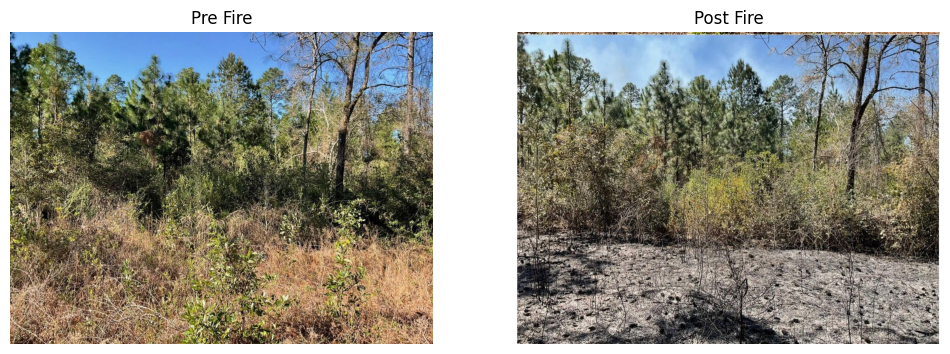

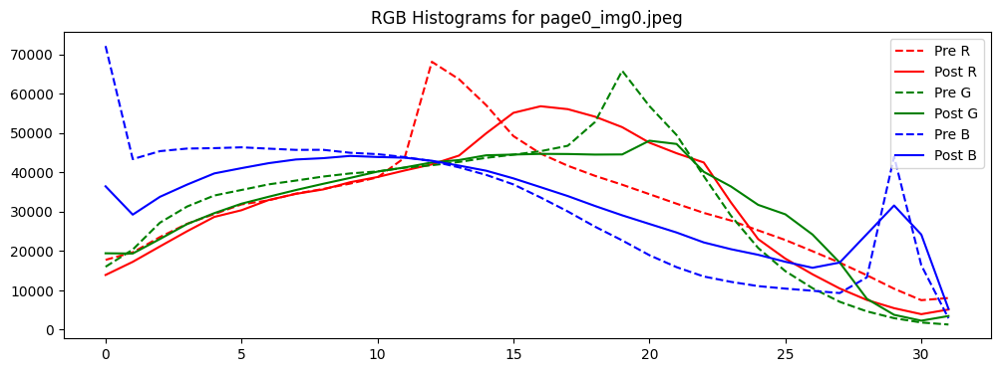


Pair: page1_img0.jpeg
Pre Image: page1_img0_pre_fire.jpeg
Post Image: page1_img0_post_fire.jpeg
Histogram Difference: 0.1678
Darkness Difference: 0.0033
Combined Scaled Score: 0.5916
Assigned Severity: high


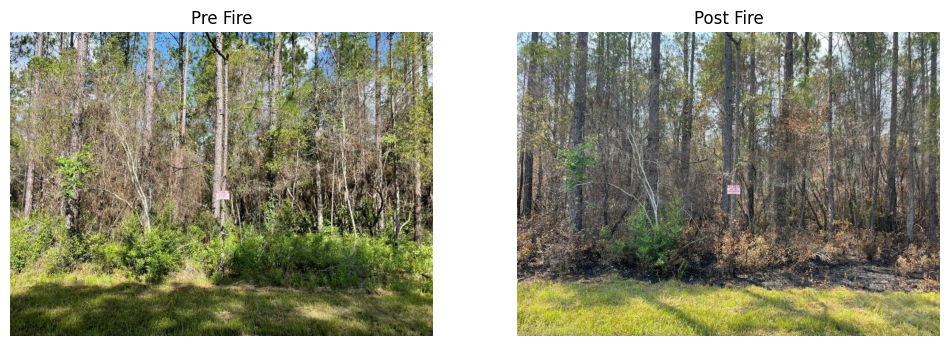

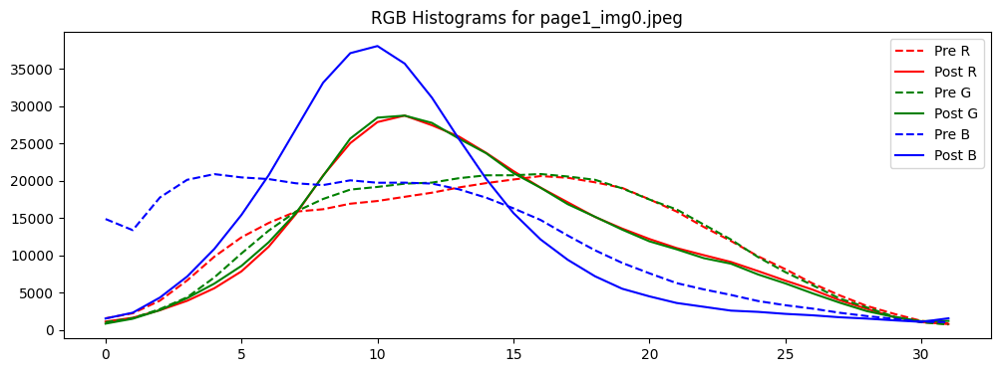


Pair: page2_img0.jpeg
Pre Image: page2_img0_pre_fire.jpeg
Post Image: page2_img0_post_fire.jpeg
Histogram Difference: 0.2094
Darkness Difference: 0.0406
Combined Scaled Score: 1.0000
Assigned Severity: extreme


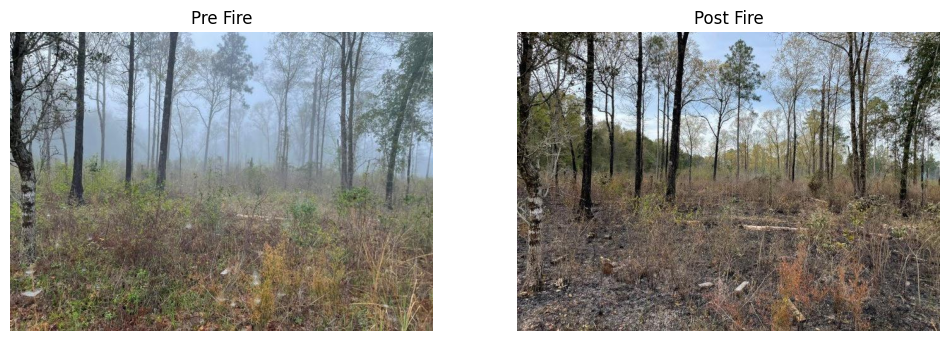

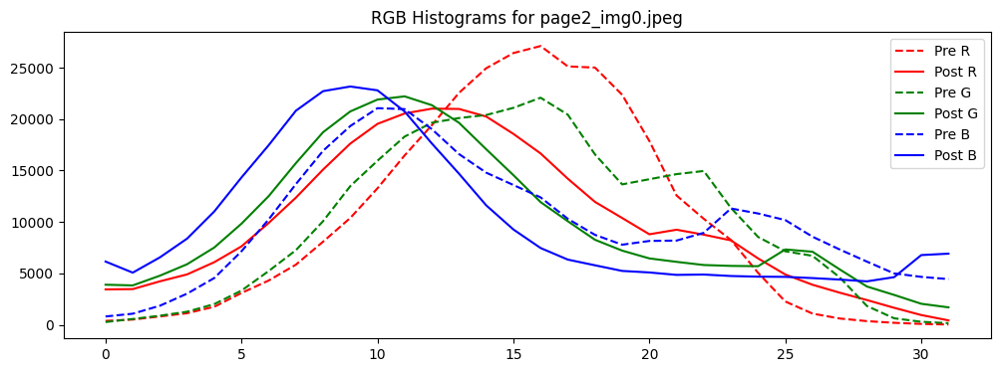


Pair: page3_img0.jpeg
Pre Image: page3_img0_pre_fire.jpeg
Post Image: page3_img0_post_fire.jpeg
Histogram Difference: 0.1371
Darkness Difference: 0.0116
Combined Scaled Score: 0.3990
Assigned Severity: moderate


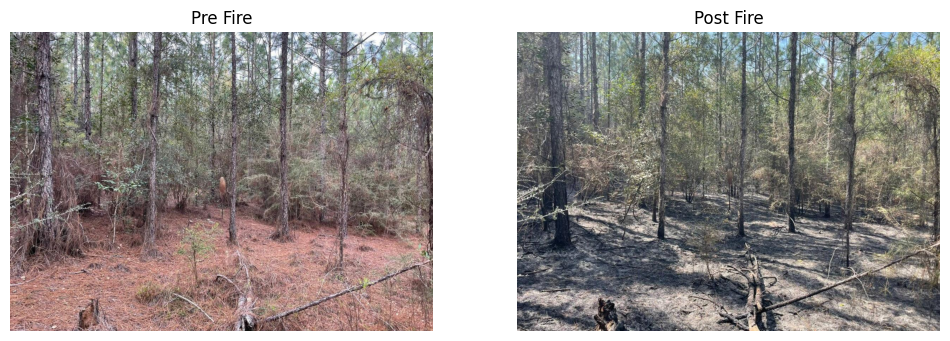

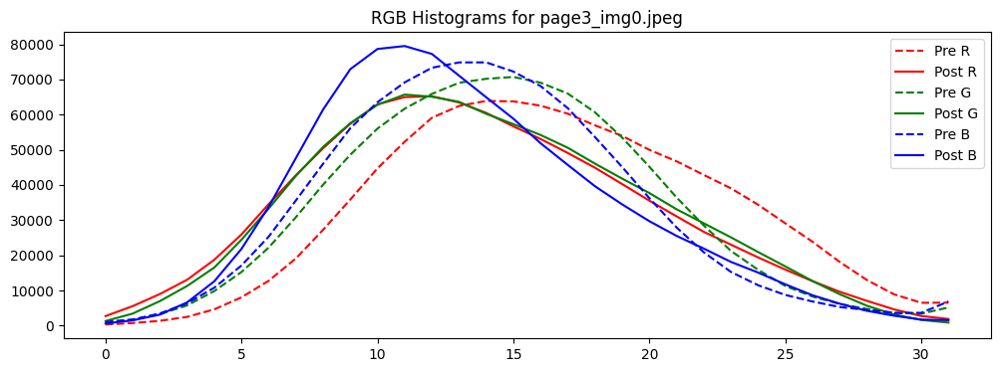


Pair: page4_img0.jpeg
Pre Image: page4_img0_pre_fire.jpeg
Post Image: page4_img0_post_fire.jpeg
Histogram Difference: 0.0832
Darkness Difference: 0.0063
Combined Scaled Score: 0.0000
Assigned Severity: none/low


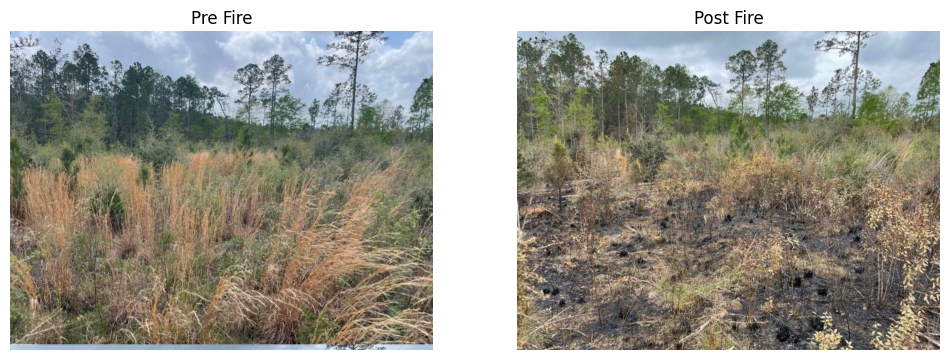

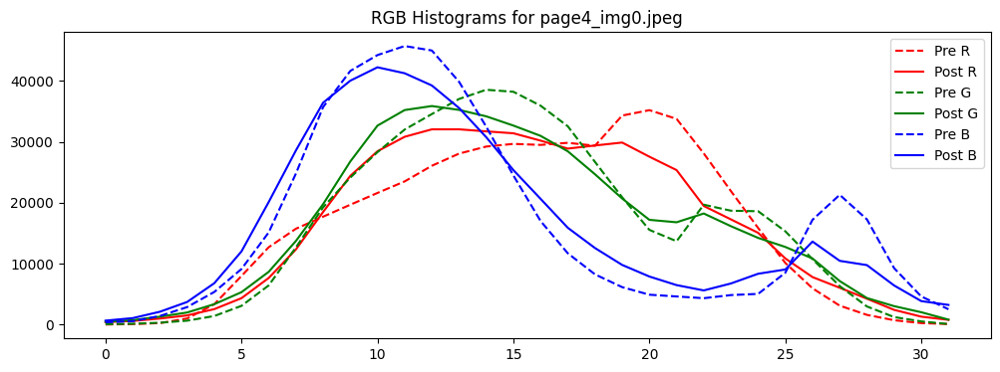


Pair: page5_img0.jpeg
Pre Image: page5_img0_pre_fire.jpeg
Post Image: page5_img0_post_fire.jpeg
Histogram Difference: 0.1104
Darkness Difference: 0.0020
Combined Scaled Score: 0.1801
Assigned Severity: none/low


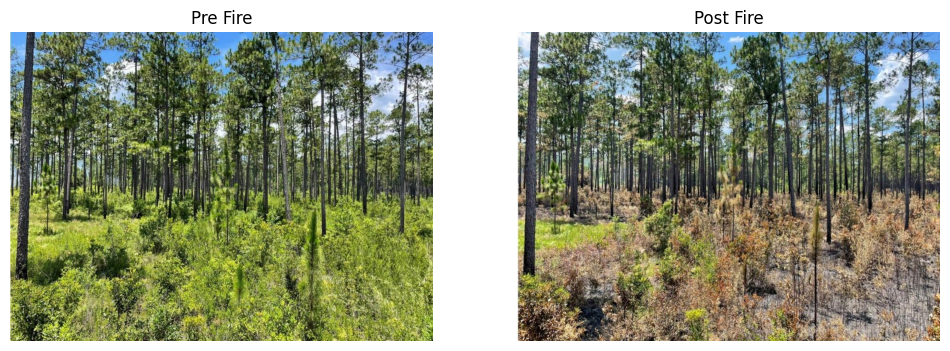

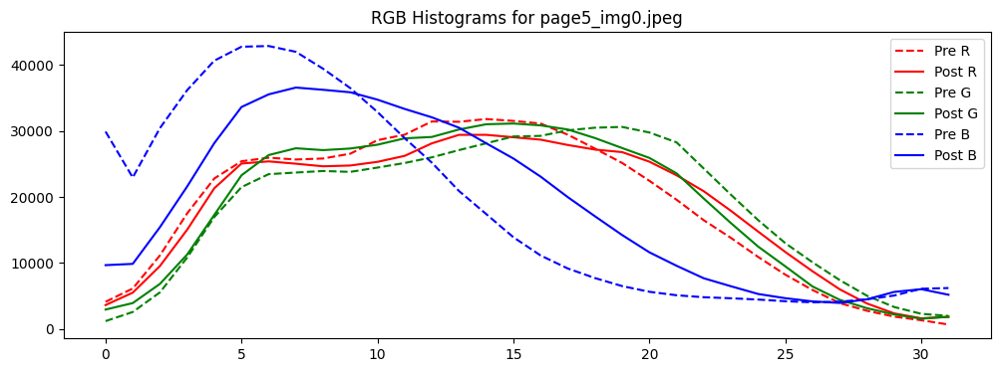


Summary Table:
         base_name                 pre_image                 post_image  \
0  page0_img0.jpeg  page0_img0_pre_fire.jpeg  page0_img0_post_fire.jpeg   
1  page1_img0.jpeg  page1_img0_pre_fire.jpeg  page1_img0_post_fire.jpeg   
2  page2_img0.jpeg  page2_img0_pre_fire.jpeg  page2_img0_post_fire.jpeg   
3  page3_img0.jpeg  page3_img0_pre_fire.jpeg  page3_img0_post_fire.jpeg   
4  page4_img0.jpeg  page4_img0_pre_fire.jpeg  page4_img0_post_fire.jpeg   
5  page5_img0.jpeg  page5_img0_pre_fire.jpeg  page5_img0_post_fire.jpeg   

   hist_diff  darkness_diff  combined_score  diff_scaled severity_label  
0   0.100019       0.006226        0.071881     0.119297       none/low  
1   0.167846       0.003250        0.118467     0.591623           high  
2   0.209371       0.040619        0.158745     1.000000        extreme  
3   0.137134       0.011566        0.099464     0.398952       moderate  
4   0.083191       0.006271        0.060115     0.000000       none/low  
5   0.110398  

In [39]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

def compute_rgb_histogram(img_path, size=(256,256), bins=32, weight_dark_pixels=False, dark_weight=3.0, dark_thresh=40):
    img = cv2.imread(img_path)
    img = cv2.resize(img, size)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    hist = np.concatenate([
        cv2.calcHist([img], [ch], None, [bins], [0, 256]).flatten()
        for ch in range(3)
    ])

    if weight_dark_pixels:
        dark_mask = np.all(img < dark_thresh, axis=2)
        dark_ratio = np.sum(dark_mask) / (img.shape[0] * img.shape[1])
        hist = hist * (1 + dark_weight * dark_ratio)

    return hist / hist.sum()

def compute_darkness_score(img_path, size=(256,256), dark_thresh=40):
    img = cv2.imread(img_path)
    img = cv2.resize(img, size)
    dark_mask = np.all(img < dark_thresh, axis=2)
    return np.sum(dark_mask) / (img.shape[0] * img.shape[1])

def calculate_histogram_difference(hist1, hist2, method=cv2.HISTCMP_BHATTACHARYYA):
    # Using OpenCV histogram comparison method, default Bhattacharyya distance
    return cv2.compareHist(hist1.astype('float32'), hist2.astype('float32'), method)

def scale_differences(scores):
    scaler = MinMaxScaler()
    scaled = scaler.fit_transform(np.array(scores).reshape(-1, 1)).flatten()
    return scaled, scaler

def assign_severity_labels(scaled_scores, bins, labels):
    # bins = list of boundaries in ascending order e.g. [0, 0.2, 0.5, 0.8, 1.0]
    # labels length = len(bins)-1
    assigned = []
    for val in scaled_scores:
        for i in range(len(bins)-1):
            if bins[i] <= val < bins[i+1]:
                assigned.append(labels[i])
                break
        else:
            assigned.append(labels[-1])
    return assigned

def get_image_pairs(image_dir, pre_tag='_pre_fire', post_tag='_post_fire'):
    files = os.listdir(image_dir)
    pairs = {}
    for f in files:
        if pre_tag in f:
            base = f.replace(pre_tag, '')
            if base not in pairs:
                pairs[base] = {}
            pairs[base]['pre'] = f
        elif post_tag in f:
            base = f.replace(post_tag, '')
            if base not in pairs:
                pairs[base] = {}
            pairs[base]['post'] = f
    return pairs

def analyze_burn_severity_with_darkness(image_dir, alpha=0.7,
                                        hist_size=(256,256),
                                        hist_bins=32,
                                        weight_dark_pixels=True,
                                        dark_weight=3.0,
                                        dark_thresh=40,
                                        diff_method=cv2.HISTCMP_BHATTACHARYYA,
                                        severity_bins=[0, 0.2, 0.5, 0.8, 1.0],
                                        severity_labels=['none/low', 'moderate', 'high', 'extreme'],
                                        pre_tag='_pre_fire',
                                        post_tag='_post_fire'):

    pairs = get_image_pairs(image_dir, pre_tag, post_tag)
    data = []
    combined_scores = []

    for base, imgs in pairs.items():
        pre_img = imgs.get('pre')
        post_img = imgs.get('post')
        if pre_img is None or post_img is None:
            print(f"Skipping incomplete pair: {base}")
            continue

        pre_path = os.path.join(image_dir, pre_img)
        post_path = os.path.join(image_dir, post_img)

        pre_hist = compute_rgb_histogram(pre_path, hist_size, hist_bins, weight_dark_pixels, dark_weight, dark_thresh)
        post_hist = compute_rgb_histogram(post_path, hist_size, hist_bins, weight_dark_pixels, dark_weight, dark_thresh)

        hist_diff = calculate_histogram_difference(pre_hist, post_hist, diff_method)

        pre_dark = compute_darkness_score(pre_path, hist_size, dark_thresh)
        post_dark = compute_darkness_score(post_path, hist_size, dark_thresh)
        darkness_diff = abs(post_dark - pre_dark)

        combined_score = alpha * hist_diff + (1 - alpha) * darkness_diff

        data.append({
            'base_name': base,
            'pre_image': pre_img,
            'post_image': post_img,
            'hist_diff': hist_diff,
            'darkness_diff': darkness_diff,
            'combined_score': combined_score
        })
        combined_scores.append(combined_score)

    scaled_scores, scaler = scale_differences(combined_scores)
    severity = assign_severity_labels(scaled_scores, severity_bins, severity_labels)

    for i, row in enumerate(data):
        row['diff_scaled'] = scaled_scores[i]
        row['severity_label'] = severity[i]

    df = pd.DataFrame(data)

    # Print detailed info and plot histograms
    for idx, row in df.iterrows():
        print(f"\nPair: {row['base_name']}")
        print(f"Pre Image: {row['pre_image']}")
        print(f"Post Image: {row['post_image']}")
        print(f"Histogram Difference: {row['hist_diff']:.4f}")
        print(f"Darkness Difference: {row['darkness_diff']:.4f}")
        print(f"Combined Scaled Score: {row['diff_scaled']:.4f}")
        print(f"Assigned Severity: {row['severity_label']}")

        # Load images
        pre_img_path = os.path.join(image_dir, row['pre_image'])
        post_img_path = os.path.join(image_dir, row['post_image'])
        pre_img_cv = cv2.imread(pre_img_path)
        post_img_cv = cv2.imread(post_img_path)

        pre_img_rgb = cv2.cvtColor(pre_img_cv, cv2.COLOR_BGR2RGB)
        post_img_rgb = cv2.cvtColor(post_img_cv, cv2.COLOR_BGR2RGB)

        # Plot images side by side
        plt.figure(figsize=(12,5))
        plt.subplot(1,2,1)
        plt.imshow(pre_img_rgb)
        plt.title("Pre Fire")
        plt.axis('off')

        plt.subplot(1,2,2)
        plt.imshow(post_img_rgb)
        plt.title("Post Fire")
        plt.axis('off')
        plt.show()

        # Plot histograms for both images
        colors = ('r', 'g', 'b')
        plt.figure(figsize=(12,4))
        for i, color in enumerate(colors):
            pre_hist_channel = cv2.calcHist([pre_img_rgb], [i], None, [hist_bins], [0,256])
            post_hist_channel = cv2.calcHist([post_img_rgb], [i], None, [hist_bins], [0,256])
            plt.plot(pre_hist_channel, color=color, linestyle='--', label=f'Pre {color.upper()}')
            plt.plot(post_hist_channel, color=color, linestyle='-', label=f'Post {color.upper()}')
        plt.title(f"RGB Histograms for {row['base_name']}")
        plt.legend()
        plt.show()

    return df


# === USAGE ===
image_dir = '/content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images'

df_results = analyze_burn_severity_with_darkness(image_dir,
                                                alpha=0.7,  # Tune this to weigh hist diff vs darkness diff
                                                weight_dark_pixels=True,
                                                dark_weight=4.0,
                                                dark_thresh=40,
                                                hist_bins=32,
                                                severity_bins=[0, 0.25, 0.5, 0.75, 1.0],
                                                severity_labels=['none/low', 'moderate', 'high', 'extreme'])
print("\nSummary Table:")
print(df_results)


# ML approach

In [53]:
import os
import numpy as np
import cv2
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# Base directory where images are stored
base_dir = '/content/drive/Shareddrives/SCO-Shared/Science Resources/Thematic Service Areas/Ecosystem&CarbonManagement/Rx_Fire/extracted_images/split_images'

# --- 1. Prepare full paths for training images and labels ---
train_pre_images = [
    os.path.join(base_dir, 'page0_img0_pre_fire.jpeg'),
    os.path.join(base_dir, 'page1_img0_pre_fire.jpeg'),
    os.path.join(base_dir, 'page2_img0_pre_fire.jpeg'),
]

train_post_images = [
    os.path.join(base_dir, 'page0_img0_post_fire.jpeg'),
    os.path.join(base_dir, 'page1_img0_post_fire.jpeg'),
    os.path.join(base_dir, 'page2_img0_post_fire.jpeg'),
]

train_labels = [2, 1, 3]  # 2: moderate, 1: none/low, 3: high

# --- 2. Prepare full paths for test images ---
test_pre_images = [
    os.path.join(base_dir, 'page3_img0_pre_fire.jpeg'),
    os.path.join(base_dir, 'page4_img0_pre_fire.jpeg'),
    os.path.join(base_dir, 'page5_img0_pre_fire.jpeg'),
]

test_post_images = [
    os.path.join(base_dir, 'page3_img0_post_fire.jpeg'),
    os.path.join(base_dir, 'page4_img0_post_fire.jpeg'),
    os.path.join(base_dir, 'page5_img0_post_fire.jpeg'),
]

# --- 3. Feature extraction function ---
def extract_features(pre_img_path, post_img_path, hist_bins=32, size=(256,256), dark_thresh=40):
    def hist_and_darkness(img_path):
        img = cv2.imread(img_path)
        if img is None:
            raise FileNotFoundError(f"Could not load image: {img_path}")
        img = cv2.resize(img, size)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        hist = np.concatenate([
            cv2.calcHist([img_rgb], [ch], None, [hist_bins], [0,256]).flatten()
            for ch in range(3)
        ])
        dark_ratio = np.sum(np.all(img_rgb < dark_thresh, axis=2)) / (size[0]*size[1])
        return hist / hist.sum(), dark_ratio

    pre_hist, pre_dark = hist_and_darkness(pre_img_path)
    post_hist, post_dark = hist_and_darkness(post_img_path)

    hist_diff = post_hist - pre_hist
    dark_diff = post_dark - pre_dark

    feature_vector = np.concatenate([pre_hist, post_hist, hist_diff, [dark_diff]])
    return feature_vector

# --- 4. Extract features for training data ---
train_features = []
for pre_path, post_path in zip(train_pre_images, train_post_images):
    train_features.append(extract_features(pre_path, post_path))
train_features = np.array(train_features)

# --- 5. Train RandomForest classifier ---
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(train_features, train_labels)

# --- 6. Extract features for test data ---
test_features = []
for pre_path, post_path in zip(test_pre_images, test_post_images):
    test_features.append(extract_features(pre_path, post_path))
test_features = np.array(test_features)

# --- 7. Predict burn severity on test set ---
predictions = clf.predict(test_features)

# --- 8. Print predictions with readable labels ---
severity_map = {
    1: 'none/low',
    2: 'moderate',
    3: 'high',
    4: 'extreme'
}

for pre, post, pred in zip(test_pre_images, test_post_images, predictions):
    print(f"Prediction for {os.path.basename(pre)} & {os.path.basename(post)}: {pred} ({severity_map.get(pred, 'unknown')})")


Prediction for page3_img0_pre_fire.jpeg & page3_img0_post_fire.jpeg: 1 (none/low)
Prediction for page4_img0_pre_fire.jpeg & page4_img0_post_fire.jpeg: 1 (none/low)
Prediction for page5_img0_pre_fire.jpeg & page5_img0_post_fire.jpeg: 1 (none/low)


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           1       0.33      1.00      0.50         1
           2       0.00      0.00      0.00         1
           3       0.00      0.00      0.00         1

    accuracy                           0.33         3
   macro avg       0.11      0.33      0.17         3
weighted avg       0.11      0.33      0.17         3



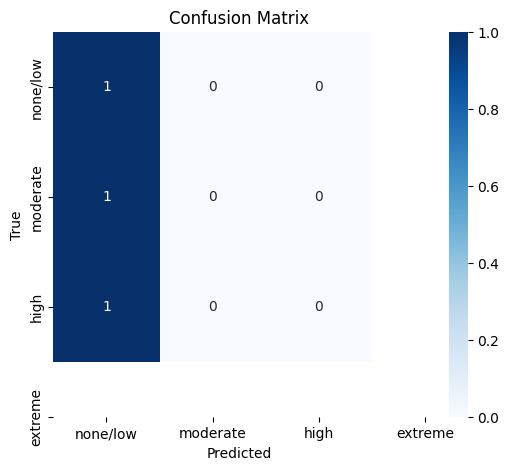

In [54]:
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# If you have test labels, e.g.,
test_labels = [1, 2, 3]  # example ground truths for test images

print(classification_report(test_labels, predictions))

# Confusion matrix plot
cm = confusion_matrix(test_labels, predictions)
plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=[severity_map[i] for i in sorted(severity_map)],
            yticklabels=[severity_map[i] for i in sorted(severity_map)])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


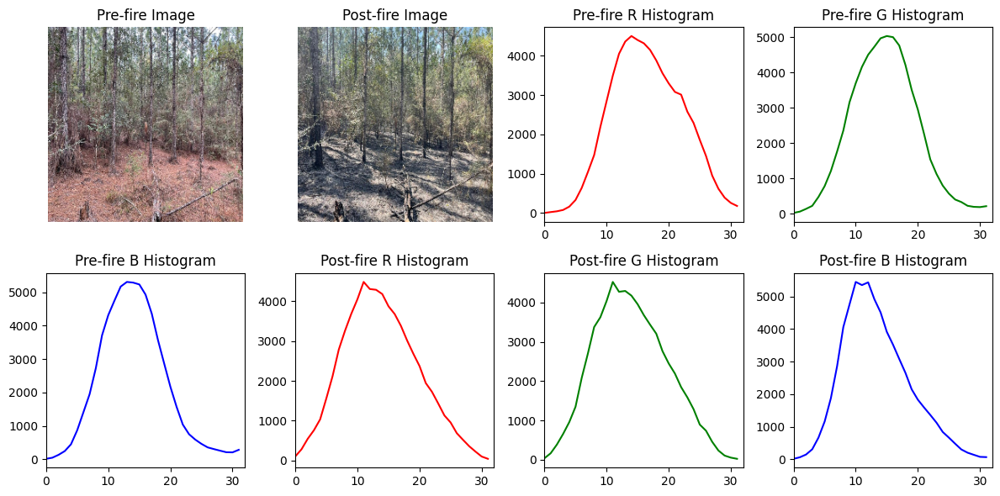

In [55]:
def plot_image_and_histograms(pre_path, post_path, size=(256,256), hist_bins=32):
    pre_img = cv2.imread(pre_path)
    post_img = cv2.imread(post_path)
    pre_img = cv2.resize(pre_img, size)
    post_img = cv2.resize(post_img, size)
    pre_img_rgb = cv2.cvtColor(pre_img, cv2.COLOR_BGR2RGB)
    post_img_rgb = cv2.cvtColor(post_img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(12,6))

    # Show pre and post fire images
    plt.subplot(2,4,1)
    plt.imshow(pre_img_rgb)
    plt.title('Pre-fire Image')
    plt.axis('off')

    plt.subplot(2,4,2)
    plt.imshow(post_img_rgb)
    plt.title('Post-fire Image')
    plt.axis('off')

    # Plot histograms for R,G,B channels pre-fire
    for i, color in enumerate(['r', 'g', 'b']):
        hist = cv2.calcHist([pre_img_rgb], [i], None, [hist_bins], [0,256])
        plt.subplot(2,4,i+3)
        plt.plot(hist, color=color)
        plt.title(f'Pre-fire {color.upper()} Histogram')
        plt.xlim([0, hist_bins])

    # Plot histograms for R,G,B channels post-fire
    for i, color in enumerate(['r', 'g', 'b']):
        hist = cv2.calcHist([post_img_rgb], [i], None, [hist_bins], [0,256])
        plt.subplot(2,4,i+6)
        plt.plot(hist, color=color)
        plt.title(f'Post-fire {color.upper()} Histogram')
        plt.xlim([0, hist_bins])

    plt.tight_layout()
    plt.show()

# Example usage on first test pair
plot_image_and_histograms(test_pre_images[0], test_post_images[0])
